In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
import glob
import math
%matplotlib inline

# Read images

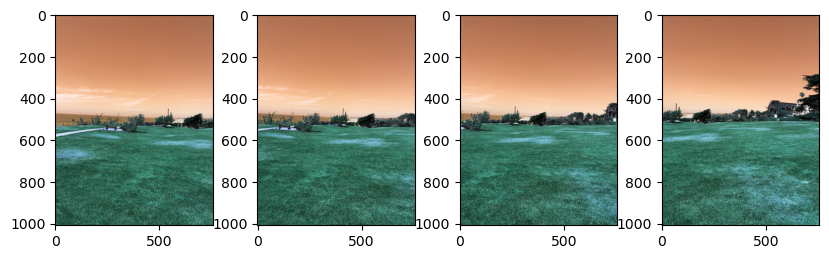

In [9]:
# Load the four input images
image1 = cv2.imread('./panorama/scene1.jpg', cv2.IMREAD_COLOR)
image2 = cv2.imread('./panorama/scene2.jpg', cv2.IMREAD_COLOR)
image3 = cv2.imread('./panorama/scene3.jpg', cv2.IMREAD_COLOR)
image4 = cv2.imread('./panorama/scene4.jpg', cv2.IMREAD_COLOR)

titles = ['image1','image2','image3','image4']
images = [image1,image2,image3,image4]
plt.figure(figsize=[10,6])
for i in range(len(titles)):
    plt.subplot(2,4,i+1)
    plt.imshow(images[i])
plt.show()



Text(0.5, 1.0, 'Scene_4')

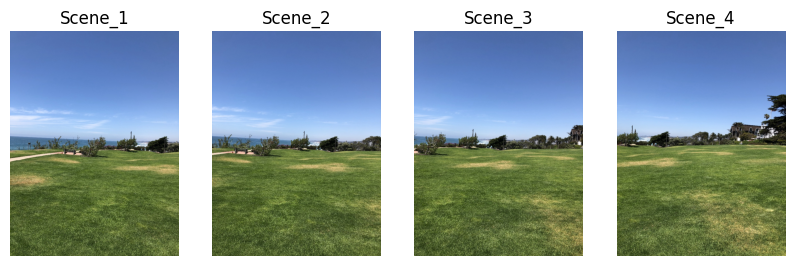

In [3]:
plt.figure(figsize=[10,6]);
plt.subplot(141); plt.axis('off'); plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)); plt.title("Scene_1")
plt.subplot(142); plt.axis('off'); plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)); plt.title("Scene_2")
plt.subplot(143); plt.axis('off'); plt.imshow(cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)); plt.title("Scene_3")
plt.subplot(144); plt.axis('off'); plt.imshow(cv2.cvtColor(image4, cv2.COLOR_BGR2RGB)); plt.title("Scene_4")

# Feature detection and description

In [4]:
im1Gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
im2Gray = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
im3Gray = cv2.cvtColor(image3, cv2.COLOR_BGR2GRAY)
im4Gray = cv2.cvtColor(image4, cv2.COLOR_BGR2GRAY)

In [5]:
# Initialize SIFT detector
sift = cv2.SIFT_create()

# Detect keypoints and compute descriptors for each image
kp1, des1 = sift.detectAndCompute(im1Gray, None)
kp2, des2 = sift.detectAndCompute(im2Gray, None)
kp3, des3 = sift.detectAndCompute(im3Gray, None)
kp4, des4 = sift.detectAndCompute(im4Gray, None)

In [6]:
img1kp = cv2.drawKeypoints(image1, kp1, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2kp = cv2.drawKeypoints(image2, kp2, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img3kp = cv2.drawKeypoints(image3, kp3, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img4kp = cv2.drawKeypoints(image4, kp4, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

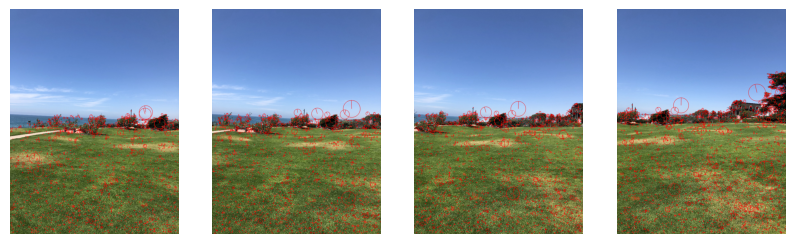

In [7]:
plt.figure(figsize=[10,6]);
plt.subplot(141); plt.axis('off'); plt.imshow(cv2.cvtColor(img1kp, cv2.COLOR_BGR2RGB));
plt.subplot(142); plt.axis('off'); plt.imshow(cv2.cvtColor(img2kp, cv2.COLOR_BGR2RGB));
plt.subplot(143); plt.axis('off'); plt.imshow(cv2.cvtColor(img3kp, cv2.COLOR_BGR2RGB));
plt.subplot(144); plt.axis('off'); plt.imshow(cv2.cvtColor(img4kp, cv2.COLOR_BGR2RGB));

# Feature Matching

In [ ]:
# Initialize a brute force matcher
bf = cv2.BFMatcher()

# Match descriptors between adjacent images
matches12 = bf.knnMatch(des1, des2, k=2)
matches23 = bf.knnMatch(des2, des3, k=2)
matches34 = bf.knnMatch(des3, des4, k=2)

# Apply Lowe's ratio test to filter good matches
good_matches12 = []
for m, n in matches12:
    if m.distance < 0.75 * n.distance:
        good_matches12.append([m])

good_matches23 = []
for m, n in matches23:
    if m.distance < 0.75 * n.distance:
        good_matches23.append([m])

good_matches34 = []
for m, n in matches34:
    if m.distance < 0.75 * n.distance:
        good_matches34.append([m])

im12_matched = cv2.drawMatchesKnn(image1,kp1,image2,kp2,good_matches12,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im23_matched = cv2.drawMatchesKnn(image2,kp2,image3,kp3,good_matches23,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im34_matched = cv2.drawMatchesKnn(image3,kp3,image4,kp4,good_matches34,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

In [9]:
im12_matched = cv2.drawMatchesKnn(image1,kp1,image2,kp2,good_matches12,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im23_matched = cv2.drawMatchesKnn(image2,kp2,image3,kp3,good_matches23,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im34_matched = cv2.drawMatchesKnn(image3,kp3,image4,kp4,good_matches34,None,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

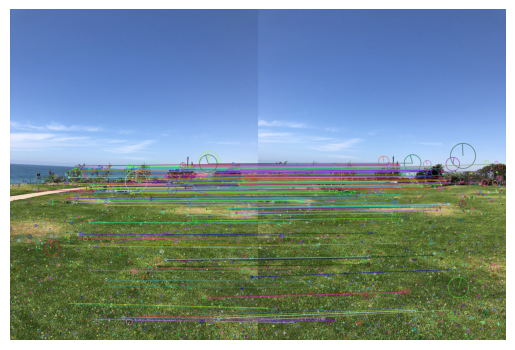

In [10]:
plt.imshow(cv2.cvtColor(im12_matched, cv2.COLOR_BGR2RGB));plt.axis('off');

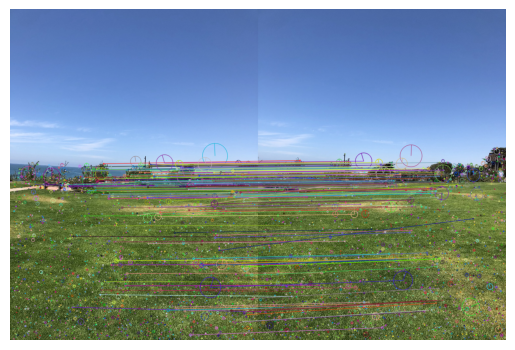

In [11]:
plt.imshow(cv2.cvtColor(im23_matched, cv2.COLOR_BGR2RGB));plt.axis('off');

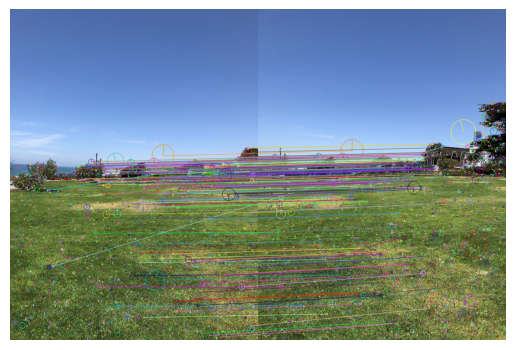

In [12]:
plt.imshow(cv2.cvtColor(im34_matched, cv2.COLOR_BGR2RGB));plt.axis('off');

In [13]:
# Use RANSAC to find the transformation matrices
def ransac_transform(kp1, kp2, matches):
  src_pts = np.zeros((len(matches), 2), dtype=np.float32)
  dst_pts = np.zeros((len(matches), 2), dtype=np.float32)

  for i, match in enumerate(matches):
      dst_pts[i, :] = kp1[match[0].queryIdx].pt
      src_pts[i, :] = kp2[match[0].trainIdx].pt

  M, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC)
  return M

M12 = ransac_transform(kp1, kp2, good_matches12)
M23 = ransac_transform(kp2, kp3, good_matches23)
M34 = ransac_transform(kp3, kp4, good_matches34)

#Warp and stitching

## Image 4 -> Image 3

### Warp image4 to image3

In [14]:
# Calculate the size of the output image
h, w = image3.shape[:2]
pano_width = w + image4.shape[1]
pano_height = h

In [15]:
print(h,w)
print(pano_width, pano_height)

1008 756
1512 1008


In [ ]:
pano = cv2.warpPerspective(image4, M34, (pano_width, pano_height)

(np.float64(-0.5), np.float64(1511.5), np.float64(1007.5), np.float64(-0.5))

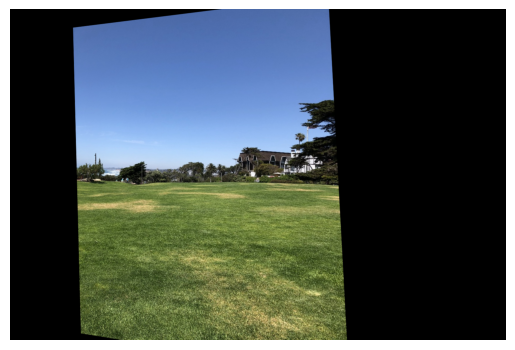

In [17]:
plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
plt.axis('off')

### Stitch image3 to warpedImg4

In [18]:
# stitch the images together
pano[:h, :w] = image3

(np.float64(-0.5), np.float64(1511.5), np.float64(1007.5), np.float64(-0.5))

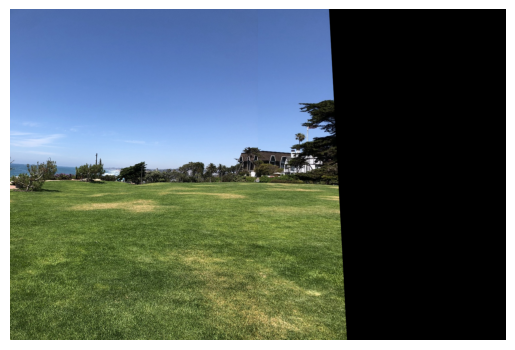

In [19]:
plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
plt.axis('off')

## Image 34 -> Image 2

### Warp stitchedImg34 to image 2

In [20]:
# Calculate the size of the output image
h, w = image2.shape[:2]
pano_width = w + pano.shape[1]
pano_height = h

print(h,w)
print(pano_width, pano_height)

1008 756
2268 1008


(np.float64(-0.5), np.float64(2267.5), np.float64(1007.5), np.float64(-0.5))

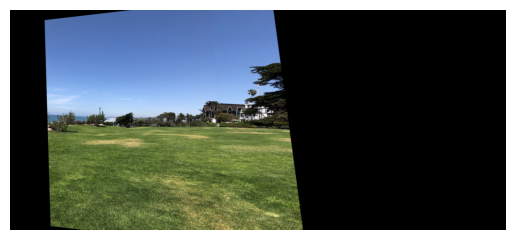

In [21]:
pano234 = cv2.warpPerspective(pano, M23, (pano_width, pano_height))
plt.imshow(cv2.cvtColor(pano234, cv2.COLOR_BGR2RGB))
plt.axis('off')

### Stitch image2 and stitchedImg34

(np.float64(-0.5), np.float64(2267.5), np.float64(1007.5), np.float64(-0.5))

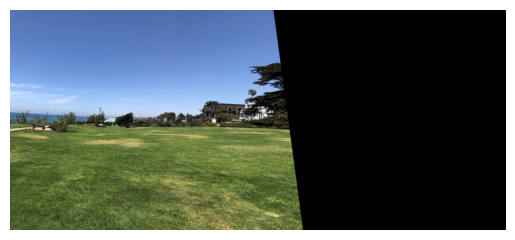

In [22]:
pano234[:h, :w] = image2
plt.imshow(cv2.cvtColor(pano234, cv2.COLOR_BGR2RGB))
plt.axis('off')

## Image 234 -> Image 1

### Warp stitchedImg234 to image 1

In [ ]:
# Calculate the size of the output image
h, w = image1.shape[:2]
pano_width = w + pano234.shape[1]
pano_height = h

print(h,w)
print(pano_width, pano_height)

1008 756
3024 1008


(np.float64(-0.5), np.float64(3023.5), np.float64(1007.5), np.float64(-0.5))

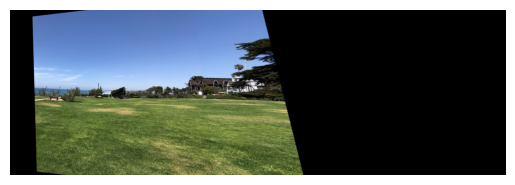

In [24]:
pano1234 = cv2.warpPerspective(pano234, M12, (pano_width, pano_height))
plt.imshow(cv2.cvtColor(pano1234, cv2.COLOR_BGR2RGB))
plt.axis('off')

### Stitch image1 with stitchedImg234

(np.float64(-0.5), np.float64(3023.5), np.float64(1007.5), np.float64(-0.5))

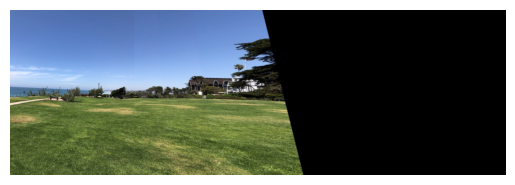

In [25]:
pano1234[:h, :w] = image1
plt.imshow(cv2.cvtColor(pano1234, cv2.COLOR_BGR2RGB))
plt.axis('off')

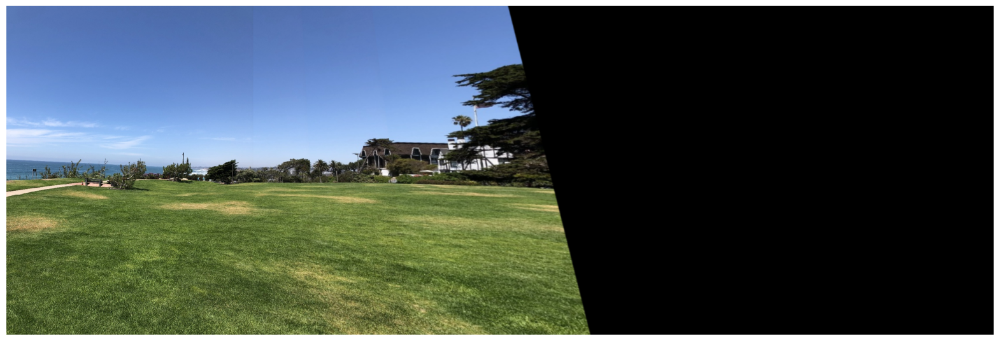

In [26]:
# cv2_imshow(pano1234)

# Use maplotlib to display the final panorama
plt.figure(figsize=[20,10])
plt.axis('off')
plt.imshow(cv2.cvtColor(pano1234, cv2.COLOR_BGR2RGB))
plt.show()

# Stitch images using OpenCV Stitch class

In [ ]:
# Read Images

imagefiles = glob.glob('./panorama/*')
print(imagefiles)
imagefiles.sort()

images = []
for filename in imagefiles:
  img = cv2.imread(filename)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  images.append(img)

num_images = len(images)
print(num_images)


['./panorama\\scene1.jpg', './panorama\\scene2.jpg', './panorama\\scene3.jpg', './panorama\\scene4.jpg', './panorama\\scene5.jpg', './panorama\\scene6.jpg', './panorama\\scene7.jpg', './panorama\\scene8.jpg']
8


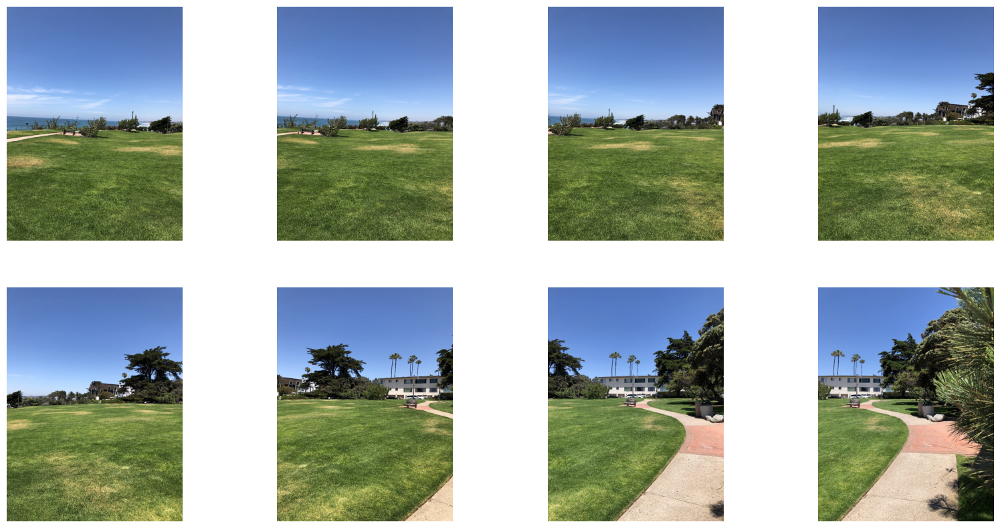

In [28]:
# Display Images
plt.figure(figsize=[20,10])
num_cols = 4
num_rows = math.ceil(num_images / num_cols)
for i in range(0, num_images):
  plt.subplot(num_rows, num_cols, i+1)
  plt.axis('off')
  plt.imshow(images[i])

## Stitch images

0


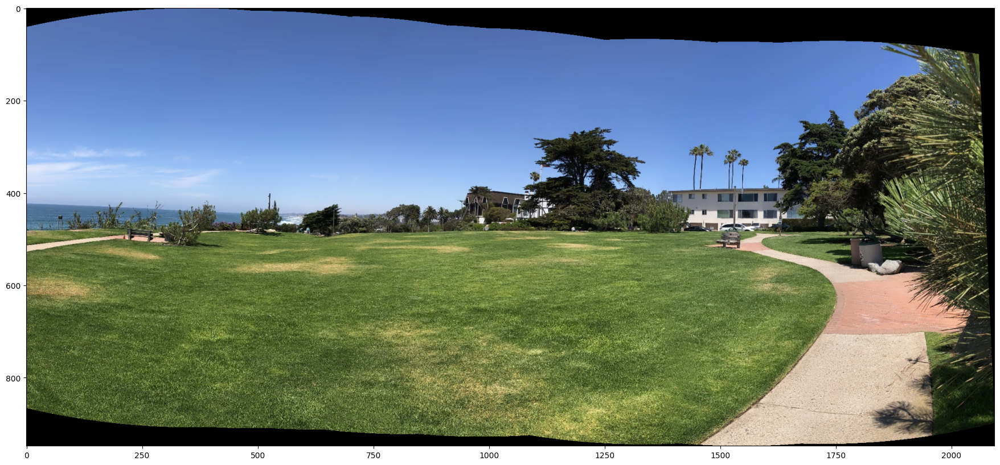

In [29]:
# Stitch Images
stitcher = cv2.Stitcher_create()
status, result = stitcher.stitch(images)
print(status)
if status == 0:
  plt.figure(figsize=[30,10])
  plt.imshow(result)

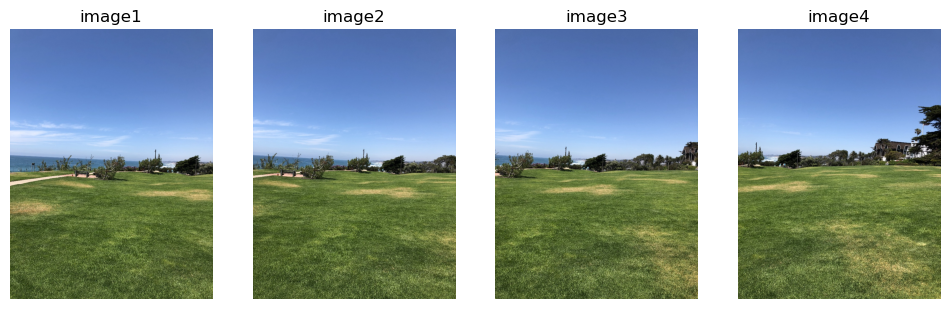

In [11]:
import cv2
import matplotlib.pyplot as plt

# Load the four input images
image1 = cv2.imread('./panorama/scene1.jpg', cv2.IMREAD_COLOR)
image2 = cv2.imread('./panorama/scene2.jpg', cv2.IMREAD_COLOR)
image3 = cv2.imread('./panorama/scene3.jpg', cv2.IMREAD_COLOR)
image4 = cv2.imread('./panorama/scene4.jpg', cv2.IMREAD_COLOR)

titles = ['image1','image2','image3','image4']
images = [image1, image2, image3, image4]

plt.figure(figsize=[12,6])

for i in range(len(titles)):
    plt.subplot(1, 4, i+1)  # 2x2 grid since you have 4 images
    img_rgb = cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB)  # Convert BGR -> RGB
    plt.imshow(img_rgb)
    plt.title(titles[i])
    plt.axis('off')  # Hide axes

plt.show()

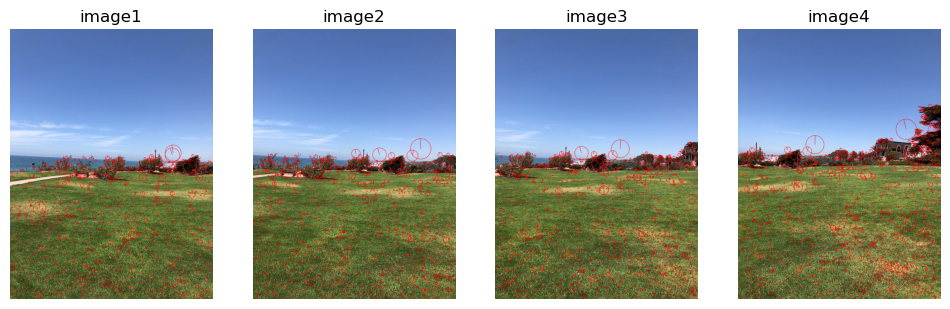

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load images
image1 = cv2.imread('./panorama/scene1.jpg')
image2 = cv2.imread('./panorama/scene2.jpg')
image3 = cv2.imread('./panorama/scene3.jpg')
image4 = cv2.imread('./panorama/scene4.jpg')

images = [image1, image2, image3, image4]
titles = ['image1', 'image2', 'image3', 'image4']

# Convert to grayscale
gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Detect keypoints and descriptors
keypoints_list = []
descriptors_list = []
keypoint_images = []

for i, gray in enumerate(gray_images):
    kp, des = sift.detectAndCompute(gray, None)
    keypoints_list.append(kp)
    descriptors_list.append(des)
    # Draw keypoints on original image
    img_kp = cv2.drawKeypoints(images[i], kp, outImage=np.array([]), color=(0,0,255),
                               flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    keypoint_images.append(img_kp)

# Plot all images with keypoints
plt.figure(figsize=[12,6])
for i in range(len(titles)):
    plt.subplot(1,4,i+1)
    img_rgb = cv2.cvtColor(keypoint_images[i], cv2.COLOR_BGR2RGB)  # Convert BGR -> RGB
    plt.imshow(img_rgb)
    plt.title(titles[i])
    plt.axis('off')

plt.show()


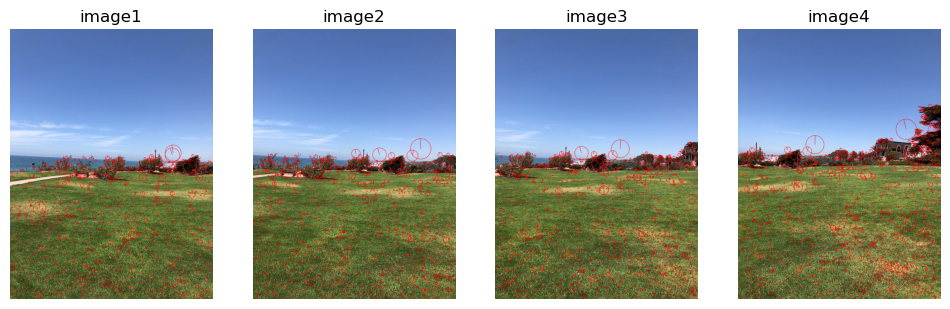

In [15]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Load the four input images
image1 = cv2.imread('./panorama/scene1.jpg', cv2.IMREAD_COLOR)
image2 = cv2.imread('./panorama/scene2.jpg', cv2.IMREAD_COLOR)
image3 = cv2.imread('./panorama/scene3.jpg', cv2.IMREAD_COLOR)
image4 = cv2.imread('./panorama/scene4.jpg', cv2.IMREAD_COLOR)

titles = ['image1','image2','image3','image4']
images = [image1,image2,image3,image4]

# Convert to grayscale
im1Gray = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
im2Gray = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)
im3Gray = cv2.cvtColor(image3, cv2.COLOR_BGR2GRAY)
im4Gray = cv2.cvtColor(image4, cv2.COLOR_BGR2GRAY)

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Detect keypoints and compute descriptors for each image
kp1, des1 = sift.detectAndCompute(im1Gray, None)
kp2, des2 = sift.detectAndCompute(im2Gray, None)
kp3, des3 = sift.detectAndCompute(im3Gray, None)
kp4, des4 = sift.detectAndCompute(im4Gray, None)

# Draw keypoints on images
img1kp = cv2.drawKeypoints(image1, kp1, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img2kp = cv2.drawKeypoints(image2, kp2, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img3kp = cv2.drawKeypoints(image3, kp3, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
img4kp = cv2.drawKeypoints(image4, kp4, outImage=np.array([]), color=(0,0,255), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Plot images with keypoints using a loop
plt.figure(figsize=[12,6])
keypoint_images = [img1kp, img2kp, img3kp, img4kp]

for i in range(len(titles)):  # <-- corrected loop
    plt.subplot(1, 4, i+1)  # 2x2 grid for 4 images
    plt.imshow(cv2.cvtColor(keypoint_images[i], cv2.COLOR_BGR2RGB))  # convert BGR -> RGB
    plt.title(titles[i])
    plt.axis('off')

plt.show()


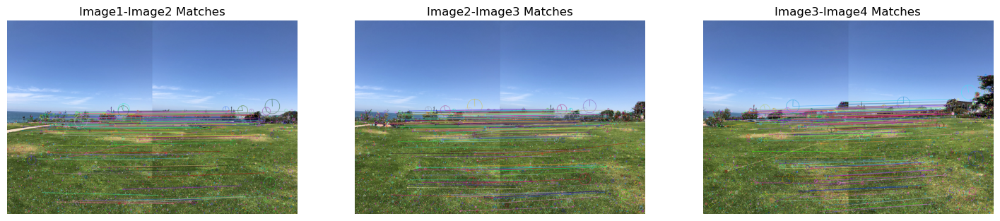

In [16]:

# Initialize a brute force matcher
bf = cv2.BFMatcher()

# Match descriptors between adjacent images using KNN
matches12 = bf.knnMatch(des1, des2, k=2)
matches23 = bf.knnMatch(des2, des3, k=2)
matches34 = bf.knnMatch(des3, des4, k=2)

# Apply Lowe's ratio test to filter good matches
def ratio_test(matches, ratio=0.75):
    good = []
    for m, n in matches:
        if m.distance < ratio * n.distance:
            good.append([m])
    return good

good_matches12 = ratio_test(matches12)
good_matches23 = ratio_test(matches23)
good_matches34 = ratio_test(matches34)

# Draw matches for visualization
im12_matched = cv2.drawMatchesKnn(image1, kp1, image2, kp2, good_matches12, None,
                                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im23_matched = cv2.drawMatchesKnn(image2, kp2, image3, kp3, good_matches23, None,
                                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im34_matched = cv2.drawMatchesKnn(image3, kp3, image4, kp4, good_matches34, None,
                                  flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# List of match images and titles
match_images = [im12_matched, im23_matched, im34_matched]
titles = ['Image1-Image2 Matches', 'Image2-Image3 Matches', 'Image3-Image4 Matches']

plt.figure(figsize=[18,6])

for i in range(len(match_images)):
    plt.subplot(1, len(match_images), i+1)
    plt.imshow(cv2.cvtColor(match_images[i], cv2.COLOR_BGR2RGB))  # Convert BGR -> RGB
    plt.title(titles[i])
    plt.axis('off')

plt.show()


In [17]:
import numpy as np
import cv2

# Function to compute homography using RANSAC
def ransac_transform(kp1, kp2, matches):
    src_pts = np.zeros((len(matches), 2), dtype=np.float32)
    dst_pts = np.zeros((len(matches), 2), dtype=np.float32)

    for i, match in enumerate(matches):
        dst_pts[i, :] = kp1[match[0].queryIdx].pt   # Destination points (reference image)
        src_pts[i, :] = kp2[match[0].trainIdx].pt   # Source points (image to warp)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC)
    return M

# Compute homography for each consecutive pair
M12 = ransac_transform(kp1, kp2, good_matches12)
M23 = ransac_transform(kp2, kp3, good_matches23)
M34 = ransac_transform(kp3, kp4, good_matches34)

# Optional: print matrices
print("Homography M12:\n", M12)
print("\nHomography M23:\n", M23)
print("\nHomography M34:\n", M34)


Homography M12:
 [[ 8.23166971e-01  2.14063024e-02  1.36654595e+02]
 [-1.10625452e-01  9.04826186e-01  4.53605062e+01]
 [-2.09144462e-04 -3.03130752e-05  1.00000000e+00]]

Homography M23:
 [[ 8.13205064e-01  2.08848873e-02  1.58028223e+02]
 [-1.09285635e-01  8.97848324e-01  5.05823919e+01]
 [-2.11699000e-04 -3.44992364e-05  1.00000000e+00]]

Homography M34:
 [[ 7.81878714e-01  1.67480392e-02  1.92068846e+02]
 [-1.18092237e-01  8.91767072e-01  5.65876076e+01]
 [-2.55273003e-04 -3.26063673e-05  1.00000000e+00]]


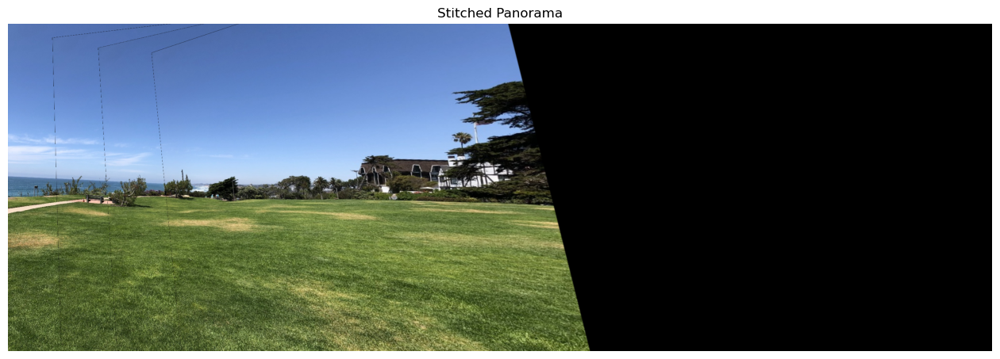

In [18]:
import cv2
import numpy as np

# List of images and homographies
images = [image1, image2, image3, image4]
homographies = [np.eye(3), M12, M12 @ M23, M12 @ M23 @ M34]  # First image is reference (identity)

# Calculate panorama canvas size
pano_width = sum(img.shape[1] for img in images)
pano_height = max(img.shape[0] for img in images)

# Create empty canvas
panorama = np.zeros((pano_height, pano_width, 3), dtype=np.uint8)

# Offset for stitching horizontally
x_offset = 0

for i in range(len(images)):
    # Warp current image to the reference coordinate system
    warped = cv2.warpPerspective(images[i], homographies[i], (pano_width, pano_height))

    # For the first image, just copy it
    if i == 0:
        panorama = warped
    else:
        # Simple stitching: overwrite non-black pixels
        mask = (warped > 0)
        panorama[mask] = warped[mask]

# Show final panorama
import matplotlib.pyplot as plt
plt.figure(figsize=[16,6])
plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Stitched Panorama')
plt.show()


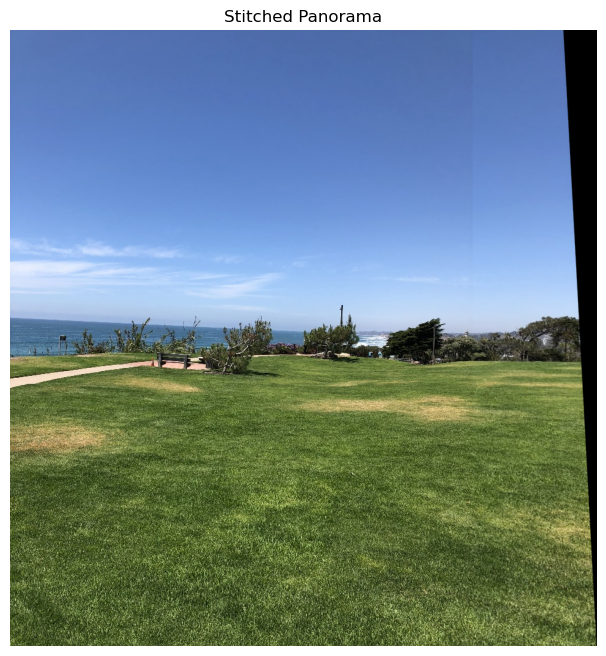

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene1.jpg')
img2 = cv2.imread('./panorama/scene2.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()


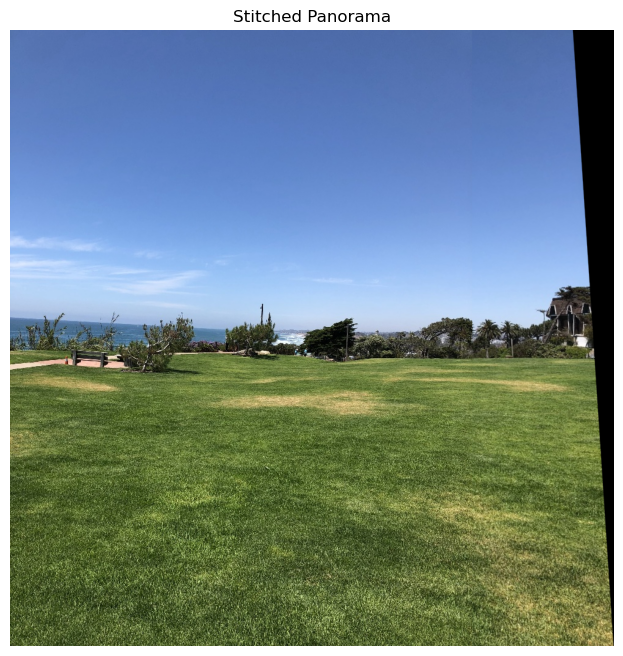

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene2.jpg')
img2 = cv2.imread('./panorama/scene3.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

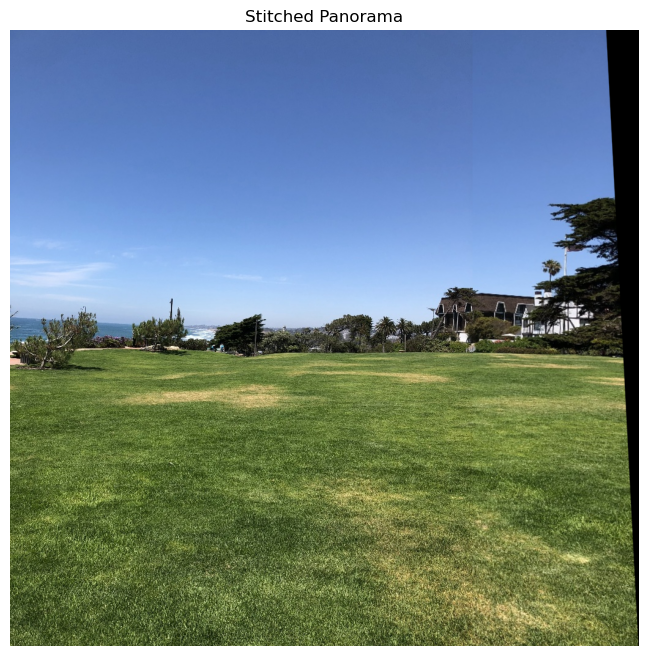

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene3.jpg')
img2 = cv2.imread('./panorama/scene4.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

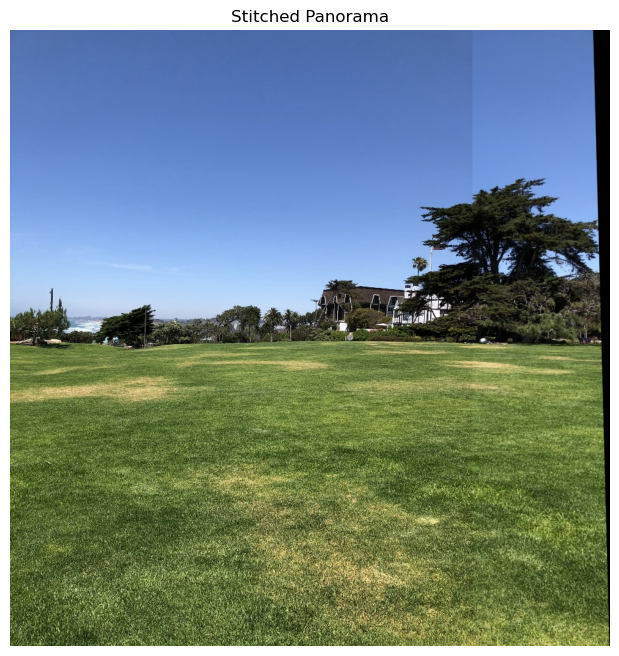

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene4.jpg')
img2 = cv2.imread('./panorama/scene5.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

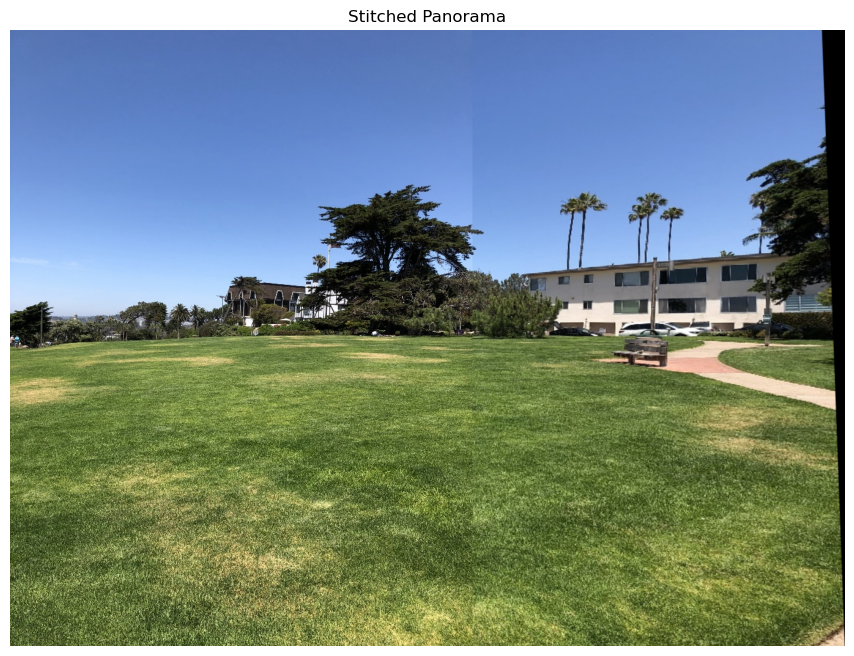

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene5.jpg')
img2 = cv2.imread('./panorama/scene6.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

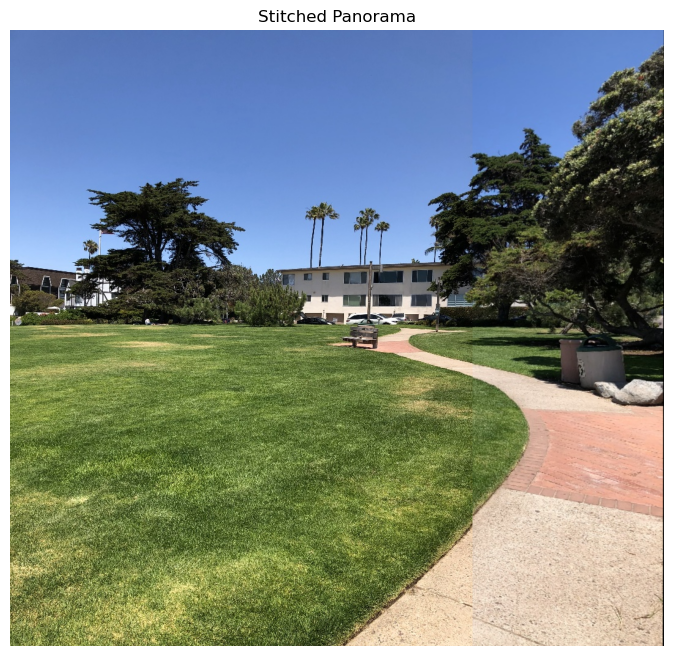

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene6.jpg')
img2 = cv2.imread('./panorama/scene7.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

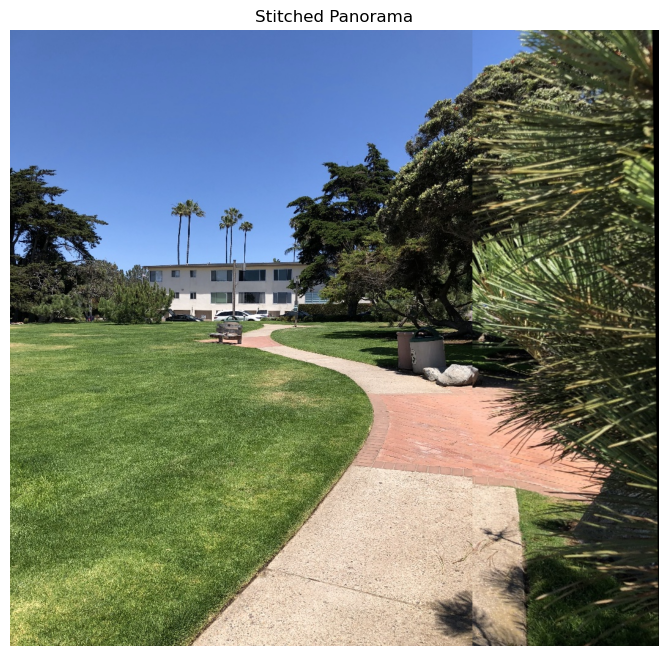

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Read images
img1 = cv2.imread('./panorama/scene7.jpg')
img2 = cv2.imread('./panorama/scene8.jpg')

# Convert to grayscale
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Detect ORB keypoints and descriptors
orb = cv2.ORB_create(5000)
kp1, des1 = orb.detectAndCompute(gray1, None)
kp2, des2 = orb.detectAndCompute(gray2, None)

# Match features using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

# Extract matched keypoints
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = kp1[match.queryIdx].pt
    points2[i, :] = kp2[match.trainIdx].pt

# Compute homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

# Warp img2 to img1's plane
height, width, channels = img1.shape
warped_img2 = cv2.warpPerspective(img2, h, (width + img2.shape[1], height))

# Place img1 onto the panorama
panorama = warped_img2.copy()
panorama[0:height, 0:width] = img1

# Optional: crop black borders
gray_panorama = cv2.cvtColor(panorama, cv2.COLOR_BGR2GRAY)
_, thresh = cv2.threshold(gray_panorama, 1, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
x, y, w, h = cv2.boundingRect(contours[0])
panorama = panorama[y:y+h, x:x+w]

# Convert BGR to RGB for matplotlib
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

# Display using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(panorama_rgb)
plt.axis('off')
plt.title("Stitched Panorama")
plt.show()

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# -------- Feature Detection --------
def detect_features(img, method="ORB"):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if method == "SIFT":
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
    else:
        orb = cv2.ORB_create(5000)
        kp, des = orb.detectAndCompute(gray, None)
    return kp, des

# -------- Feature Matching --------
def match_features(des1, des2, method="ORB"):
    if method == "SIFT":
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    else:
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    return matches

# -------- Homography Estimation --------
def find_homography(kp1, kp2, matches):
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

# -------- Warp and Blend --------
def warp_and_blend(base_img, new_img, H):
    h_base, w_base = base_img.shape[:2]
    h_new, w_new = new_img.shape[:2]
    canvas_w = w_base + w_new
    canvas_h = max(h_base, h_new)
    warped_new = cv2.warpPerspective(new_img, H, (canvas_w, canvas_h))
    warped_new[0:h_base, 0:w_base] = base_img
    return warped_new

# -------- Crop black borders --------
def crop_black_border(pano):
    gray = cv2.cvtColor(pano, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return pano
    x, y, w, h = cv2.boundingRect(contours[0])
    return pano[y:y+h, x:x+w]

# -------- Incremental Panorama Stitching --------
def incremental_panorama(images, method="ORB"):
    if len(images) < 2:
        raise ValueError("Need at least two images")
    
    panorama = images[0].copy()  # first image as base
    
    for i in range(1, len(images)):
        print(f"Stitching image {i+1} onto panorama...")
        kp1, des1 = detect_features(panorama, method)
        kp2, des2 = detect_features(images[i], method)
        matches = match_features(des1, des2, method)
        if len(matches) < 4:
            print(f"Warning: Not enough matches for image {i+1}")
            continue
        H = find_homography(kp1, kp2, matches)
        panorama = warp_and_blend(panorama, images[i], H)
        panorama = crop_black_border(panorama)
    
    return panorama



Stitching image 2 onto panorama...
Stitching image 3 onto panorama...
Stitching image 4 onto panorama...


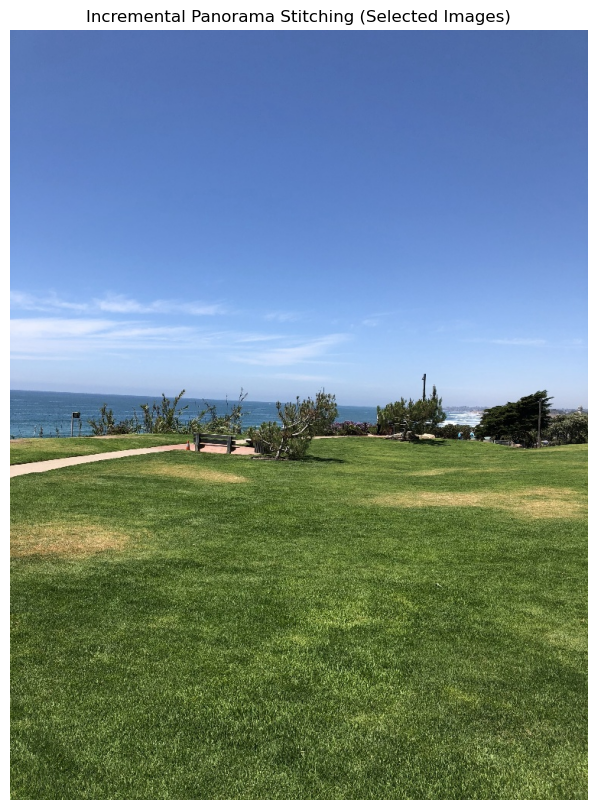

In [20]:
# -------- Main Program (Select Specific Images) --------
if __name__ == "__main__":
    folder = "panorama"  # folder containing your images

    # Specify the exact images you want, in order
    selected_images = [
        "scene1.jpg",
        "scene2.jpg",
        "scene3.jpg",
        "scene4.jpg",   # for example, skip scene4
   
    ]

    # Build full paths
    image_paths = [os.path.join(folder, img_name) for img_name in selected_images]

    # Read images
    images = [cv2.imread(p) for p in image_paths]
    for i, img in enumerate(images):
        if img is None:
            raise FileNotFoundError(f"Cannot read image: {image_paths[i]}")

    # Incremental stitching: first image as base, then stitch sequentially
    pano = incremental_panorama(images, method="ORB")

    # Display result
    plt.figure(figsize=(20, 10))
    plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
    plt.title("Incremental Panorama Stitching (Selected Images)")
    plt.axis("off")
    plt.show()


Stitching image 2 onto panorama...
Stitching image 3 onto panorama...
Stitching image 4 onto panorama...


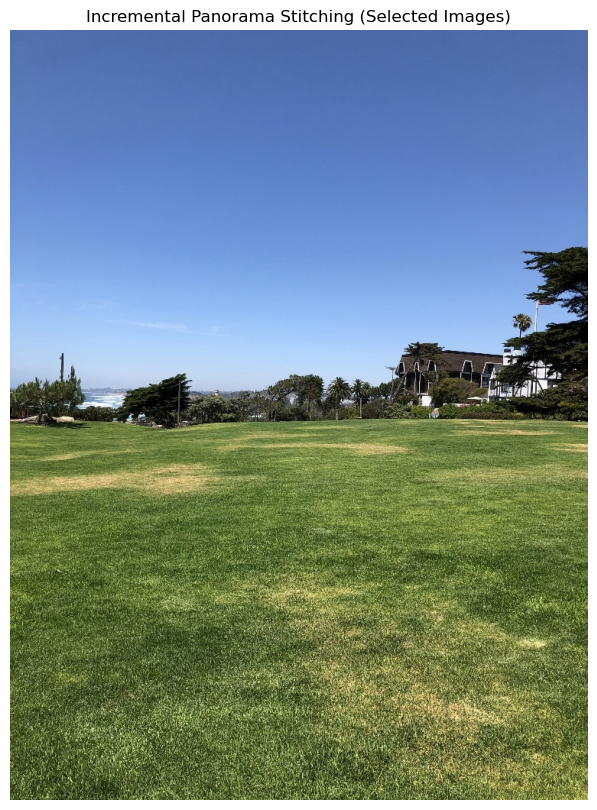

In [31]:
# -------- Main Program (Select Specific Images) --------
if __name__ == "__main__":
    folder = "panorama"  # folder containing your images

    # Specify the exact images you want, in order
    selected_images = [
        
        "scene4.jpg",
        "scene5.jpg",
        "scene6.jpg",
        "scene7.jpg",


   
   
    ]

    # Build full paths
    image_paths = [os.path.join(folder, img_name) for img_name in selected_images]

    # Read images
    images = [cv2.imread(p) for p in image_paths]
    for i, img in enumerate(images):
        if img is None:
            raise FileNotFoundError(f"Cannot read image: {image_paths[i]}")

    # Incremental stitching: first image as base, then stitch sequentially
    pano = incremental_panorama(images, method="ORB")

    # Display result
    plt.figure(figsize=(20, 10))
    plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
    plt.title("Incremental Panorama Stitching (Selected Images)")
    plt.axis("off")
    plt.show()


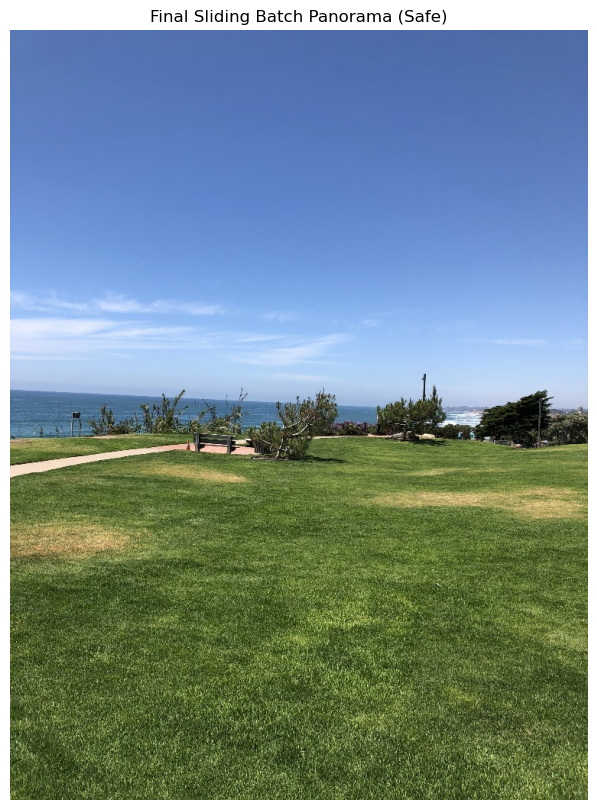

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# -------- Feature Detection / Matching / Homography / Warp --------
def detect_features(img, method="ORB"):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if method == "SIFT":
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
    else:
        orb = cv2.ORB_create(5000)
        kp, des = orb.detectAndCompute(gray, None)
    return kp, des

def match_features(des1, des2, method="ORB"):
    if method == "SIFT":
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    else:
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    return sorted(matches, key=lambda x: x.distance)

def find_homography(kp1, kp2, matches):
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
    H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

def warp_and_blend(base_img, new_img, H):
    h_base, w_base = base_img.shape[:2]
    h_new, w_new = new_img.shape[:2]
    canvas_w = w_base + w_new
    canvas_h = max(h_base, h_new)
    warped_new = cv2.warpPerspective(new_img, H, (canvas_w, canvas_h))
    warped_new[0:h_base, 0:w_base] = base_img
    return warped_new

def crop_black_border(pano):
    gray = cv2.cvtColor(pano, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray,1,255,cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return pano
    x,y,w,h = cv2.boundingRect(contours[0])
    return pano[y:y+h, x:x+w]

def incremental_panorama(images, method="ORB"):
    pano = images[0].copy()
    for i in range(1,len(images)):
        kp1, des1 = detect_features(pano, method)
        kp2, des2 = detect_features(images[i], method)
        matches = match_features(des1, des2, method)
        if len(matches)<4:
            print(f"Not enough matches between image {i} and previous pano")
            continue
        H = find_homography(kp1,kp2,matches)
        pano = warp_and_blend(pano, images[i], H)
        pano = crop_black_border(pano)
    return pano

# -------- Main Program (Sliding Batch) --------
if __name__ == "__main__":
    folder = "panorama"
    image_files = ["scene1.jpg","scene2.jpg","scene3.jpg","scene4.jpg"]
    imgs = [cv2.imread(os.path.join(folder,f)) for f in image_files]

    # Create sliding batches automatically
    sliding_batches = []
    for i in range(len(imgs)-1):
        sliding_batches.append(imgs[i:i+2])  # batch size=2

    # Stitch each batch
    batch_panos = [incremental_panorama(batch) for batch in sliding_batches]

    # Merge overlapping batch panoramas using only the overlapping images
    final_pano = incremental_panorama([batch_panos[0], imgs[2]])  # merge batch1 + next image
    final_pano = incremental_panorama([final_pano, imgs[3]])       # merge result + last image

    # Display
    plt.figure(figsize=(20,10))
    plt.imshow(cv2.cvtColor(final_pano, cv2.COLOR_BGR2RGB))
    plt.title("Final Sliding Batch Panorama (Safe)")
    plt.axis("off")
    plt.show()


In [52]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# -------- Feature Detection --------
def detect_features(img, method="ORB"):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    if method == "SIFT":
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
    else:
        orb = cv2.ORB_create(5000)
        kp, des = orb.detectAndCompute(gray, None)
    return kp, des

# -------- Feature Matching --------
def match_features(des1, des2, method="ORB"):
    if method == "SIFT":
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    else:
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    return matches

# -------- Homography Estimation --------
def find_homography(kp1, kp2, matches):
    src_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    return H

# -------- Warp and Blend --------
def warp_and_blend(base_img, new_img, H):
    h_base, w_base = base_img.shape[:2]
    h_new, w_new = new_img.shape[:2]
    canvas_w = w_base + w_new
    canvas_h = max(h_base, h_new)
    warped_new = cv2.warpPerspective(new_img, H, (canvas_w, canvas_h))
    warped_new[0:h_base, 0:w_base] = base_img
    return warped_new

# -------- Crop black borders --------
def crop_black_border(pano):
    gray = cv2.cvtColor(pano, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return pano
    x, y, w, h = cv2.boundingRect(contours[0])
    return pano[y:y+h, x:x+w]

# -------- Incremental Panorama Stitching --------
def incremental_panorama(images, method="ORB"):
    if len(images) < 2:
        raise ValueError("Need at least two images")
    
    panorama = images[0].copy()  # first image as base
    
    for i in range(1, len(images)):
        print(f"Stitching image {i+1} onto panorama...")
        kp1, des1 = detect_features(panorama, method)
        kp2, des2 = detect_features(images[i], method)
        matches = match_features(des1, des2, method)
        if len(matches) < 4:
            print(f"Warning: Not enough matches for image {i+1}")
            continue
        H = find_homography(kp1, kp2, matches)
        panorama = warp_and_blend(panorama, images[i], H)
        panorama = crop_black_border(panorama)
    
    return panorama



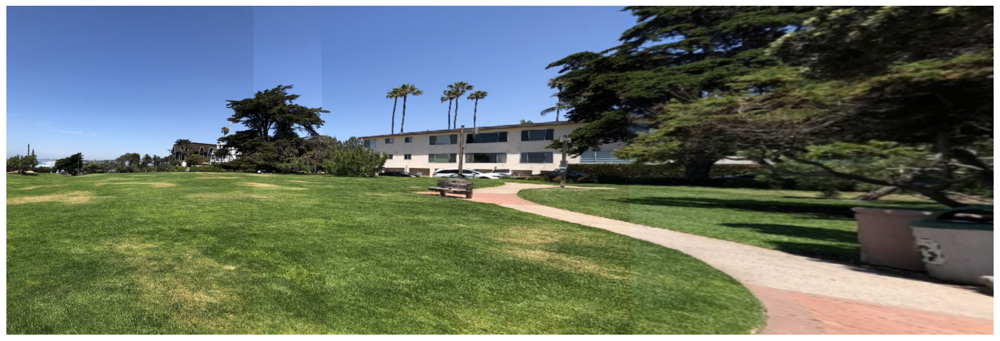

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

class PanoramaStitcher:
    def __init__(self, images):
        """
        images: list of images in the order you want to stitch [img1, img2, img3, img4]
        """
        self.images = images
        self.gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]
        self.sift = cv2.SIFT_create()
        self.keypoints = []
        self.descriptors = []

        # Compute keypoints and descriptors
        for gray in self.gray_images:
            kp, des = self.sift.detectAndCompute(gray, None)
            self.keypoints.append(kp)
            self.descriptors.append(des)
        
        # Initialize BFMatcher
        self.bf = cv2.BFMatcher()

    def match_images(self, des1, des2):
        matches = self.bf.knnMatch(des1, des2, k=2)
        good = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good.append([m])
        return good

    def ransac_transform(self, kp1, kp2, matches):
        src_pts = np.zeros((len(matches), 2), dtype=np.float32)
        dst_pts = np.zeros((len(matches), 2), dtype=np.float32)
        for i, match in enumerate(matches):
            dst_pts[i, :] = kp1[match[0].queryIdx].pt
            src_pts[i, :] = kp2[match[0].trainIdx].pt
        M, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC)
        return M

    def stitch(self):
        # Match and compute homographies
        M12 = self.ransac_transform(self.keypoints[0], self.keypoints[1], self.match_images(self.descriptors[0], self.descriptors[1]))
        M23 = self.ransac_transform(self.keypoints[1], self.keypoints[2], self.match_images(self.descriptors[1], self.descriptors[2]))
        M34 = self.ransac_transform(self.keypoints[2], self.keypoints[3], self.match_images(self.descriptors[2], self.descriptors[3]))

        # Warp 4th image onto 3rd
        h3, w3 = self.images[2].shape[:2]
        pano_width = w3 + self.images[3].shape[1]
        pano_height = h3
        pano = cv2.warpPerspective(self.images[3], M34, (pano_width, pano_height))
        pano[:h3, :w3] = self.images[2]

        # Warp the above result onto 2nd image
        h2, w2 = self.images[1].shape[:2]
        pano_width = w2 + pano.shape[1]
        pano_height = h2
        pano234 = cv2.warpPerspective(pano, M23, (pano_width, pano_height))
        pano234[:h2, :w2] = self.images[1]

        # Warp the above result onto 1st image
        h1, w1 = self.images[0].shape[:2]
        pano_width = w1 + pano234.shape[1]
        pano_height = h1
        pano1234 = cv2.warpPerspective(pano234, M12, (pano_width, pano_height))
        pano1234[:h1, :w1] = self.images[0]

        return pano1234

    def show_panorama(self, pano):
        plt.figure(figsize=[20,10])
        plt.axis('off')
        plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
        plt.show()


# ---------------- Usage ----------------
image1 = cv2.imread('./panorama/scene4.jpg')
image2 = cv2.imread('./panorama/scene5.jpg')
image3 = cv2.imread('./panorama/scene6.jpg')
image4 = cv2.imread('./panorama/scene7.jpg')
image5 = cv2.imread('./panorama/scene8.jpg')


images = [image1, image2, image3, image4,image5]

stitcher = PanoramaStitcher(images)
final_pano = stitcher.stitch()
stitcher.show_panorama(final_pano)
